In [79]:
%matplotlib inline
import numpy as np
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt

In [45]:
from pandas_profiling import ProfileReport

In [46]:
#reading the file using dask
import dask.dataframe as dd
%time df = pd.read_csv("master_dataset.csv")

Wall time: 1.41 s


In [47]:
profile = ProfileReport(df, title= 'EDA of COVID-19 Dataset', explorative=True)
profile.to_notebook_iframe()

In [3]:
df['country'] = df['country'].fillna(df['country'].mode()[0])

df['smoking'] = df['smoking'].fillna(df['smoking'].mode()[0])

df['text_working'] = df['text_working'].fillna(df['text_working'].mode()[0])

# Filling Missing observations in Continuous variables in the dataset:
df['rate_reducing_mask'].fillna(df['rate_reducing_mask'].mean(), inplace=True)
#df['bmi'].fillna(df['bmi'].mean(), inplace=True)

df['alcohol'].fillna(df['alcohol'].mean(), inplace=True)
df['cannabis'].fillna(df['cannabis'].mean(), inplace=True)
df['amphetamines'].fillna(df['amphetamines'].mean(), inplace=True)
df['lsd'].fillna(df['lsd'].mean(), inplace=True)
df['mdma'].fillna(df['mdma'].mean(), inplace=True)
df['cocaine'].fillna(df['cocaine'].mean(), inplace=True)
df['contacts_count'].fillna(df['contacts_count'].mean(), inplace=True)
df['lung_disease'].fillna(df['lung_disease'].mean(), inplace=True)
df['diabetes'].fillna(df['diabetes'].mean(), inplace=True)
df['hiv_positive'].fillna(df['hiv_positive'].mean(), inplace=True)
df['hypertension'].fillna(df['hypertension'].mean(), inplace=True)
df['other_chronic'].fillna(df['other_chronic'].mean(), inplace=True)
df['opinion_infection'].fillna(df['opinion_infection'].mean(), inplace=True)
df['bmi'].fillna(df['bmi'].mean(), inplace=True)

df['opinion_mortality'].fillna(df['opinion_mortality'].mean(), inplace=True)
df['risk_infection'].fillna(df['risk_infection'].mean(), inplace=True)
df['risk_mortality'].fillna(df['risk_mortality'].mean(), inplace=True)
df['heart_disease'].fillna(df['heart_disease'].mean(), inplace=True)

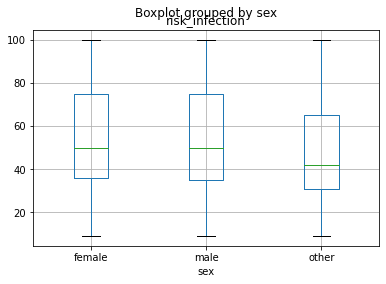

In [4]:
df.boxplot(['risk_infection'], by='sex', showfliers=True)
plt.show()

In [5]:
from sklearn.preprocessing import StandardScaler
#df[['cannabis', 'cocaine', 'amphetamines', 'lsd', 'mdma']] = StandardScaler().fit_transform(df[['cannabis', 'cocaine', 'amphetamines', 'lsd', 'mdma']])

In [6]:
col = df.loc[: , 'cannabis':'mdma']
df['drugs_use'] = col.mean(axis=1)

In [7]:
column3drop = ['cannabis', 'amphetamines', 'cocaine', 'lsd', 'mdma','opinion_mortality', 'risk_mortality']
df.drop(column3drop, axis=1, inplace=True)

In [8]:
# We want to know how well does each feature correlate with the dependent variable
corr = df.corr() #method : {‘pearson’, ‘kendall’, ‘spearman’}

#Correlation with the variable risk_infection
cor_target = (corr["risk_infection"])

#Selecting highly correlated features
relevant_features = cor_target[cor_target>=0.0]
relevant_features

bmi                  0.058807
contacts_count       0.888682
house_count          0.335922
covid19_positive     0.073692
covid19_symptoms     0.110243
covid19_contact      0.236475
asthma               0.002455
opinion_infection    0.202818
risk_infection       1.000000
drugs_use            0.018066
Name: risk_infection, dtype: float64

In [9]:
df.columns

Index(['region', 'country', 'sex', 'age', 'bmi', 'blood_type', 'smoking',
       'alcohol', 'contacts_count', 'house_count', 'text_working',
       'rate_government_action', 'rate_reducing_risk_single',
       'rate_reducing_risk_house', 'rate_reducing_mask', 'covid19_positive',
       'covid19_symptoms', 'covid19_contact', 'asthma', 'kidney_disease',
       'compromised_immune', 'heart_disease', 'lung_disease', 'diabetes',
       'hiv_positive', 'hypertension', 'other_chronic',
       'prescription_medication', 'opinion_infection', 'risk_infection',
       'drugs_use'],
      dtype='object')

In [10]:
column3drop = ['region', 'prescription_medication']
df.drop(column3drop, axis=1, inplace=True)

In [11]:
from sklearn.preprocessing import LabelEncoder
label_encoders = dict()
column2encode = ['sex', 'age', 'country','blood_type', 'smoking', 'drugs_use',
                'text_working', 'rate_government_action', 'rate_reducing_risk_single', 
                'rate_reducing_risk_house', 'bmi']

for col in column2encode:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])
    label_encoders[col] = le

In [ ]:
from patsy import dmatrices
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [ ]:
#df.dropna()
#df_1 = df._get_numeric_data() #drop non-numeric cols

In [15]:
df.columns

Index(['country', 'sex', 'age', 'bmi', 'blood_type', 'smoking', 'alcohol',
       'contacts_count', 'house_count', 'text_working',
       'rate_government_action', 'rate_reducing_risk_single',
       'rate_reducing_risk_house', 'rate_reducing_mask', 'covid19_positive',
       'covid19_symptoms', 'covid19_contact', 'asthma', 'kidney_disease',
       'compromised_immune', 'heart_disease', 'lung_disease', 'diabetes',
       'hiv_positive', 'hypertension', 'other_chronic', 'opinion_infection',
       'risk_infection', 'drugs_use'],
      dtype='object')

In [16]:
## removing multicollinearity 
# create a Python list of feature names
independent_variables = ['country', 'sex', 'age', 'bmi', 'blood_type', 'smoking', 'alcohol',
       'contacts_count', 'house_count', 'text_working',
       'rate_government_action', 'rate_reducing_risk_single',
       'rate_reducing_risk_house', 'rate_reducing_mask', 'covid19_positive',
       'covid19_symptoms', 'covid19_contact', 'asthma', 'kidney_disease',
       'compromised_immune', 'heart_disease', 'lung_disease', 'diabetes',
       'hiv_positive', 'hypertension', 'other_chronic', 'opinion_infection',
        'drugs_use']
# use the list to select a subset from original DataFrame
X = df[independent_variables]
y = df['risk_infection']

In [17]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
thresh = 2.5
for i in np.arange(0,len(independent_variables)):
    vif = [variance_inflation_factor(X[independent_variables].values, ix)
for ix in range(X[independent_variables].shape[1])]
    maxloc = vif.index(max(vif))
    if max(vif) > thresh:
        print("vif :", vif)
        print('dropping \'' + X[independent_variables].columns[maxloc] + '\'at index: ' + str(maxloc))
        del independent_variables[maxloc]
    else:
        break
print('Final variables:', independent_variables)

vif : [9.968806186360089, 1.5437706133320446, 11.59304550078957, 6.711603518432332, 6.705524712212258, 1.6808578794944165, 1.5062310515730977, 3.218091944842836, 5.247784186609535, 7.229884737626641, 8.088766168635201, 38.39847103284272, 28.79457379374014, 5.398092082867605, 1.0143269391046523, 1.045996912427747, 1.10666343332758, 1.2280147670518449, 1.0200702626572704, 1.1731970273251018, 1.091753715228338, 1.0680604076721125, 1.1735539109264737, 1.010172643573648, 1.3401024459107596, 1.1879447548006394, 4.554759649367363, 1.6170347699032632]
dropping 'rate_reducing_risk_single'at index: 11
vif : [9.811283707185087, 1.5430943653942035, 11.332304973023238, 6.644445417450072, 6.59228025527353, 1.6808549564116806, 1.505917599341139, 3.1930911388627683, 5.212504022188902, 7.184655685452455, 7.8706135011381075, 17.11843902677632, 5.220908198267903, 1.0141504294038761, 1.0458593471795765, 1.1066344351483641, 1.2270705317489383, 1.0200397377051413, 1.1729669725599006, 1.0912200809886534, 1.0

In [20]:
#df['risk_infection'] = pd.cut(df.risk_infection,bins=[0,34,67,100],labels=['Low','Medium','High'])
#df['bmi'] = pd.cut(df.bmi,bins=[0,18.5,24.9,29.9,39.9,145],labels=['Underweight','Healthy weight','Overweight','Obese',
                                                                 #'Class 3 Obese'])

In [12]:
column4drop = ['bmi', 'rate_reducing_risk_single', 'rate_reducing_risk_house', 'age', 
              'country','text_working', 'rate_government_action', 'bmi', 'blood_type', 'house_count', 'opinion_infection' ]
df.drop(column4drop, axis=1, inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 682793 entries, 0 to 682792
Data columns (total 19 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   sex                 682793 non-null  int32  
 1   smoking             682793 non-null  int32  
 2   alcohol             682793 non-null  float64
 3   contacts_count      682793 non-null  float64
 4   rate_reducing_mask  682793 non-null  float64
 5   covid19_positive    682793 non-null  int64  
 6   covid19_symptoms    682793 non-null  int64  
 7   covid19_contact     682793 non-null  int64  
 8   asthma              682793 non-null  int64  
 9   kidney_disease      682793 non-null  int64  
 10  compromised_immune  682793 non-null  int64  
 11  heart_disease       682793 non-null  int64  
 12  lung_disease        682793 non-null  int64  
 13  diabetes            682793 non-null  int64  
 14  hiv_positive        682793 non-null  int64  
 15  hypertension        682793 non-nul

In [19]:
# drop the columns identfied by VIF analysis 
#column4drop = ['region']
#df.drop(column4drop, axis=1, inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 682793 entries, 0 to 682792
Data columns (total 19 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   sex                 682793 non-null  int32  
 1   smoking             682793 non-null  int32  
 2   alcohol             682793 non-null  float64
 3   contacts_count      682793 non-null  float64
 4   rate_reducing_mask  682793 non-null  float64
 5   covid19_positive    682793 non-null  int64  
 6   covid19_symptoms    682793 non-null  int64  
 7   covid19_contact     682793 non-null  int64  
 8   asthma              682793 non-null  int64  
 9   kidney_disease      682793 non-null  int64  
 10  compromised_immune  682793 non-null  int64  
 11  heart_disease       682793 non-null  int64  
 12  lung_disease        682793 non-null  int64  
 13  diabetes            682793 non-null  int64  
 14  hiv_positive        682793 non-null  int64  
 15  hypertension        682793 non-nul

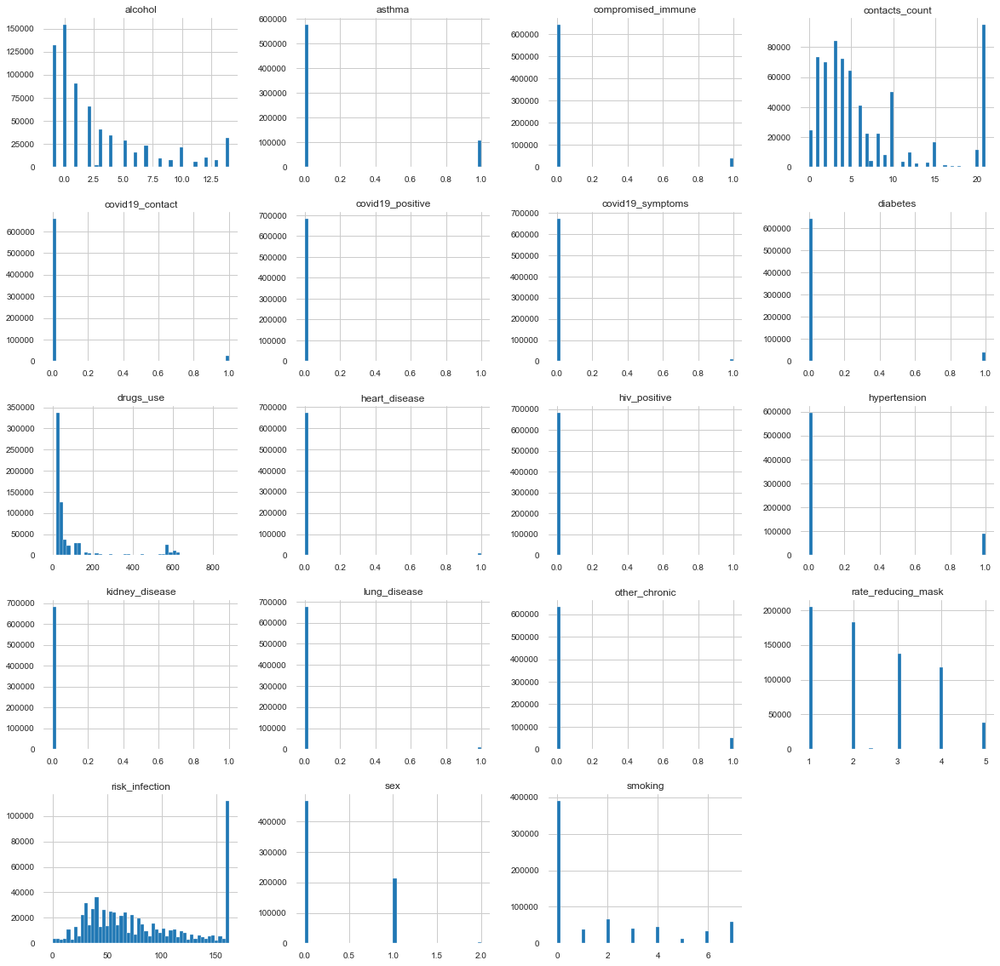

In [20]:
%matplotlib inline
import matplotlib.pyplot as plt
df.hist(bins=50, figsize=(20,20))
#save_fig("attribute_histogram_plots")
plt.show()

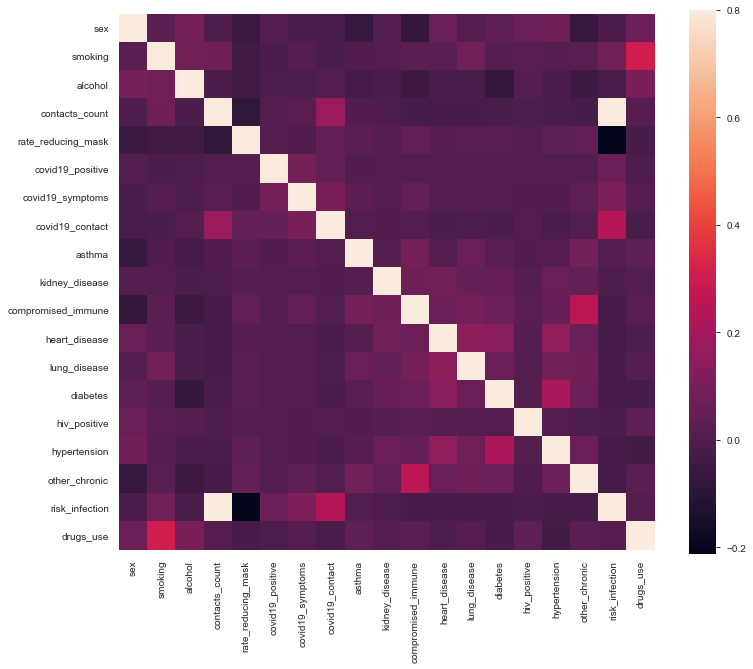

In [21]:
# Correlation matrix
import seaborn as sns

cor = df.corr()
fig = plt.figure(figsize = (12,10))
sns.heatmap(cor,vmax = 0.8, square = True)
plt.show()

In [13]:
#Correlation with the variable risk_infection after VIF 
cor_target = (corr["risk_infection"])

#Selecting highly correlated features
relevant_features = cor_target[cor_target>=0.0]
relevant_features#Correlation with the variable covid19_positive
cor_target = (corr["risk_infection"])

#Selecting highly correlated features
relevant_features = cor_target[cor_target>=0.0]
relevant_features

bmi                  0.058807
contacts_count       0.888682
house_count          0.335922
covid19_positive     0.073692
covid19_symptoms     0.110243
covid19_contact      0.236475
asthma               0.002455
opinion_infection    0.202818
risk_infection       1.000000
drugs_use            0.018066
Name: risk_infection, dtype: float64

In [23]:
df.columns

Index(['sex', 'smoking', 'alcohol', 'contacts_count', 'rate_reducing_mask',
       'covid19_positive', 'covid19_symptoms', 'covid19_contact', 'asthma',
       'kidney_disease', 'compromised_immune', 'heart_disease', 'lung_disease',
       'diabetes', 'hiv_positive', 'hypertension', 'other_chronic',
       'risk_infection', 'drugs_use'],
      dtype='object')

In [21]:
# Import library for VIF, check for multicollinearity among the independent variables 
from statsmodels.stats.outliers_influence import variance_inflation_factor
def calc_vif(X):

    # Calculating VIF
    vif = pd.DataFrame()
    vif["variables"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    return(vif)

In [22]:
X = df.iloc[:,:-1]
calc_vif(X)

,variables,VIF
0,sex,1.463889
1,smoking,1.522195
2,alcohol,1.422747
3,contacts_count,7.336495
4,rate_reducing_mask,3.009251
5,covid19_positive,1.020305
6,covid19_symptoms,1.056074
7,covid19_contact,1.093853
8,asthma,1.205813
9,kidney_disease,1.019321


We can see here that the ‘contacts’ and ‘risk_infection’ have a high VIF value, meaning they can be predicted by other independent variables in the dataset.

In [23]:
# Fixing multicollinearity issues
X = df.drop(['contacts_count','risk_infection'],axis=1)
calc_vif(X)

,variables,VIF
0,sex,1.406142
1,smoking,1.594359
2,alcohol,1.391725
3,rate_reducing_mask,2.052300
4,covid19_positive,1.012446
5,covid19_symptoms,1.037773
6,covid19_contact,1.051781
7,asthma,1.188062
8,kidney_disease,1.019322
9,compromised_immune,1.168009


In [24]:
df.columns

Index(['sex', 'smoking', 'alcohol', 'contacts_count', 'rate_reducing_mask',
       'covid19_positive', 'covid19_symptoms', 'covid19_contact', 'asthma',
       'kidney_disease', 'compromised_immune', 'heart_disease', 'lung_disease',
       'diabetes', 'hiv_positive', 'hypertension', 'other_chronic',
       'risk_infection', 'drugs_use'],
      dtype='object')

In [28]:
from sklearn.preprocessing import StandardScaler
independent_variables = ['sex', 'smoking', 'alcohol', 'contacts_count', 'rate_reducing_mask',
       'covid19_positive', 'covid19_symptoms', 'covid19_contact', 'asthma',
       'kidney_disease', 'compromised_immune', 'heart_disease', 'lung_disease',
       'diabetes', 'hiv_positive', 'hypertension', 'other_chronic', 'drugs_use']
# use the list to select a subset from original DataFrame
# Separating out the features
x = df.loc[:, independent_variables].values
df['risk_infection'] = pd.cut(df.risk_infection,bins=[0,34,67,100],labels=['Low','Medium','High'])
# Separating out the target
y = df.loc[:,['risk_infection']].values
# Standardizing the features
X = StandardScaler().fit_transform(x)

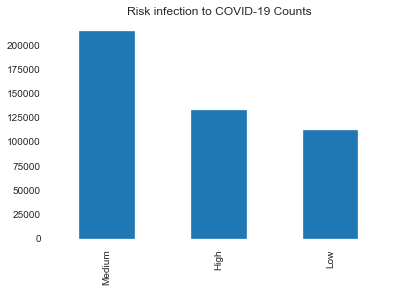

In [29]:
df['risk_infection'].value_counts()
df['risk_infection'].value_counts()
df['risk_infection'].value_counts().plot(kind='bar', 
                                   title='Risk infection to COVID-19 Counts')
plt.show()

In [30]:
from sklearn.decomposition import PCA
pca = PCA(n_components=10)
principalComponents = pca.fit_transform(X)
principalDf = pd.DataFrame(data = principalComponents, 
                           columns = ['principal_component_1', 'principal_component_2', 'principal_component_3', 
                                      'principal_component_4', 'principal_component_5', 'principal_component_6', 
                                      'principal_component_7', 'principal_component_8', 'principal_component_9', 
                                      'principal_component_10'])

In [31]:
df.head()

,sex,smoking,alcohol,contacts_count,rate_reducing_mask,covid19_positive,covid19_symptoms,covid19_contact,asthma,kidney_disease,compromised_immune,heart_disease,lung_disease,diabetes,hiv_positive,hypertension,other_chronic,risk_infection,drugs_use
0,1,0,2.731708,7.368875,2.417397,0,0,0,0,0,0,0,0,0,0,0,0,NaN,110
1,1,0,2.731708,7.368875,2.417397,0,0,0,0,0,1,0,1,1,0,1,0,NaN,110
2,0,0,2.731708,7.368875,2.417397,0,0,0,0,0,0,0,0,0,0,0,0,NaN,110
3,1,0,2.731708,7.368875,2.417397,0,0,0,0,0,0,0,0,1,0,1,0,NaN,110
4,0,0,2.731708,7.368875,2.417397,0,0,0,0,0,1,0,0,0,0,0,1,NaN,110


In [32]:
finalDf = pd.concat([principalDf, df[['risk_infection']]], axis = 1)

In [33]:
finalDf.head()

,principal_component_1,principal_component_2,principal_component_3,principal_component_4,principal_component_5,principal_component_6,principal_component_7,principal_component_8,principal_component_9,principal_component_10,risk_infection
0,-0.745590,0.053510,-0.798070,0.174934,0.373773,0.223401,0.284542,0.143983,-0.031164,-0.318407,NaN
1,6.655460,0.533648,-1.989134,0.534662,-0.726095,-0.608510,-0.698133,0.771229,3.047438,-0.080296,NaN
2,-0.714073,-0.563059,0.033956,-0.215753,-0.047113,-0.046169,-0.010786,0.253697,-0.104197,0.218133,NaN
3,1.934201,-0.170956,-2.973421,1.500304,-0.382315,-0.222937,-0.179903,-2.200381,-0.917932,-0.462038,NaN
4,2.531846,-1.022953,2.442395,-1.657952,0.050723,0.675741,1.793551,-0.045404,-1.750267,-1.572701,NaN


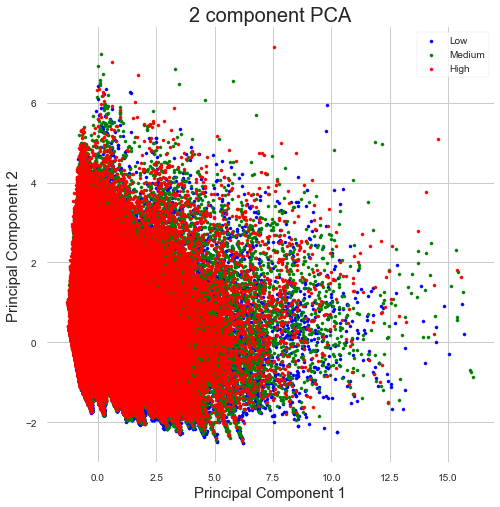

In [34]:
# Visualization of the PCA 
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = ['Low', 'Medium', 'High']
colors = ['b', 'g', 'r']
for risk_infection, color in zip(targets,colors):
    indicesToKeep = finalDf['risk_infection'] == risk_infection
    ax.scatter(finalDf.loc[indicesToKeep, 'principal_component_1']
               , finalDf.loc[indicesToKeep, 'principal_component_2']
               , c = color
               , s = 10)
ax.legend(targets)
ax.grid()

In [35]:
pca.explained_variance_ratio_

array([0.09094922, 0.07853582, 0.07241886, 0.06767179, 0.05926901,
       0.05590225, 0.05572217, 0.05429233, 0.0536565 , 0.05317907])

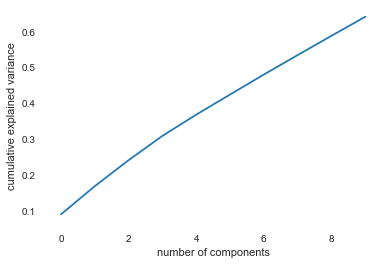

In [36]:
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');

The curve quantifies how much of the total, 10-dimensional variance is contained within the first N components. From the line plot above, we see that with the dimensions in the first 9 components contain approximately 65% of the variance, while you need around 20 components to describe close to 100% of the variance.

Here we see that our two-dimensional projection loses a lot of information (as measured by the explained variance) and that we'd need about 15 components to retain 90% of the variance. Looking at this plot for a high-dimensional dataset can help us understand the level of redundancy present in multiple observations.

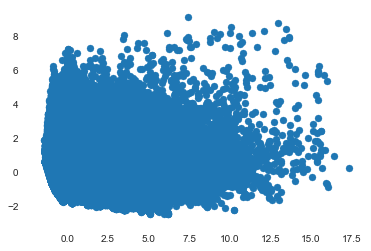

In [37]:
# Visualize true data points before the applications of K-means clustering 
plt.scatter(principalDf.iloc[:,0],principalDf.iloc[:,1], label='True Position')

In [38]:
from sklearn.cluster import KMeans

km = KMeans(
    n_clusters=3, init='random',
    n_init=10, max_iter=300, 
    tol=1e-04, random_state=0
)
y_km = km.fit_predict(principalDf)

In [39]:
km.labels_[:5]

array([0, 2, 0, 0, 2])

In [40]:
np.unique(km.labels_, return_counts=True)

(array([0, 1, 2]), array([456203, 150837,  75753], dtype=int64))

C:\Users\Hp\anaconda3\lib\site-packages\IPython\core\pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


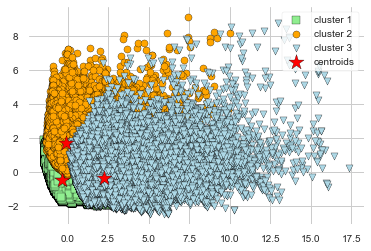

In [41]:
# plot the 3 clusters
plt.scatter(
    principalDf.iloc[y_km == 0, 0], principalDf.iloc[y_km == 0, 1],
    s=50, c='lightgreen',
    marker='s', edgecolor='black',
    label='cluster 1')

plt.scatter(
    principalDf.iloc[y_km == 1, 0], principalDf.iloc[y_km == 1, 1],
    s=50, c='orange',
    marker='o', edgecolor='black',
    label='cluster 2')

plt.scatter(
    principalDf.iloc[y_km == 2, 0], principalDf.iloc[y_km == 2, 1],
    s=50, c='lightblue',
    marker='v', edgecolor='black',
    label='cluster 3')

# plot the centroids
plt.scatter(
    km.cluster_centers_[:, 0], km.cluster_centers_[:, 1],
    s=250, marker='*',
    c='red', edgecolor='black',
    label='centroids')
plt.legend(scatterpoints=1)
plt.grid()
plt.show()

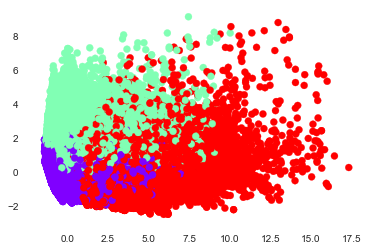

In [42]:
# Visualize the data points after applying the k-means clustering  
plt.scatter(principalDf.iloc[:,0],principalDf.iloc[:,1], c=km.labels_, cmap='rainbow')

In [43]:
# Performing Centering of the k-means 
km.cluster_centers_

array([[-0.35095876, -0.49063408, -0.26299176,  0.17170678,  0.0424693 ,
         0.00396531, -0.02994417,  0.04620975,  0.1410726 , -0.03265117],
       [-0.07840907,  1.67727307,  0.18006905, -0.18288605, -0.14526333,
        -0.16708554, -0.30347288, -0.15688987, -0.0702444 ,  0.43185705],
       [ 2.26774052, -0.39445907,  1.22289675, -0.66811909,  0.03430103,
         0.30946959,  0.7855479 ,  0.03499317, -0.70854059, -0.66510068]])

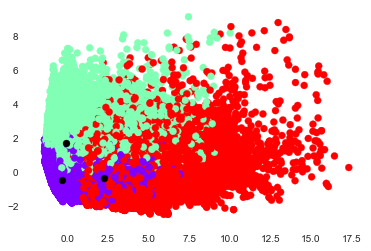

In [44]:
# Visualising the clusters after centering 
#Plot the centroid. This time we're going to use the cluster centres  

plt.scatter(principalDf.iloc[:,0], principalDf.iloc[:,1], c=km.labels_, cmap='rainbow')
plt.scatter(km.cluster_centers_[:,0] ,km.cluster_centers_[:,1], color='black')

In [45]:
# Determining the exact cluster number using the silhouette elbow approach 
from sklearn.cluster import DBSCAN
from sklearn import metrics
print('SSE %s' % km.inertia_)
print('Silhouette %s' % metrics.silhouette_score(principalDf, km.labels_))

SSE 6498230.530915409
Silhouette 0.2081348911726303


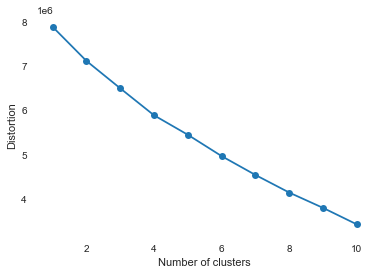

In [46]:
# calculate distortion for a range of number of cluster
distortions = []
for i in range(1, 11):
    km = KMeans(
        n_clusters=i, init='random',
        n_init=10, max_iter=300,
        tol=1e-04, random_state = 0                                                                                                                                                                                                                                                                                        
    )
    km.fit(principalDf)
    distortions.append(km.inertia_)

# plot
plt.plot(range(1, 11), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.show()

In [15]:
import dask.dataframe as dd
%time df = pd.read_csv("master_dataset.csv")

Wall time: 3.27 s


In [16]:
df['country'] = df['country'].fillna(df['country'].mode()[0])

df['smoking'] = df['smoking'].fillna(df['smoking'].mode()[0])

df['text_working'] = df['text_working'].fillna(df['text_working'].mode()[0])

# Filling Missing observations in Continuous variables in the dataset:
df['rate_reducing_mask'].fillna(df['rate_reducing_mask'].mean(), inplace=True)
#df['bmi'].fillna(df['bmi'].mean(), inplace=True)

df['alcohol'].fillna(df['alcohol'].mean(), inplace=True)
df['cannabis'].fillna(df['cannabis'].mean(), inplace=True)
df['amphetamines'].fillna(df['amphetamines'].mean(), inplace=True)
df['lsd'].fillna(df['lsd'].mean(), inplace=True)
df['mdma'].fillna(df['mdma'].mean(), inplace=True)
df['cocaine'].fillna(df['cocaine'].mean(), inplace=True)
df['contacts_count'].fillna(df['contacts_count'].mean(), inplace=True)
df['lung_disease'].fillna(df['lung_disease'].mean(), inplace=True)
df['diabetes'].fillna(df['diabetes'].mean(), inplace=True)
df['hiv_positive'].fillna(df['hiv_positive'].mean(), inplace=True)
df['hypertension'].fillna(df['hypertension'].mean(), inplace=True)
df['other_chronic'].fillna(df['other_chronic'].mean(), inplace=True)
df['opinion_infection'].fillna(df['opinion_infection'].mean(), inplace=True)
df['bmi'].fillna(df['bmi'].mean(), inplace=True)

df['opinion_mortality'].fillna(df['opinion_mortality'].mean(), inplace=True)
df['risk_infection'].fillna(df['risk_infection'].mean(), inplace=True)
df['risk_mortality'].fillna(df['risk_mortality'].mean(), inplace=True)
df['heart_disease'].fillna(df['heart_disease'].mean(), inplace=True)

In [17]:
col = df.loc[: , 'cannabis':'mdma']
df['drugs_use'] = col.mean(axis=1)

In [18]:
column3drop = ['cannabis', 'amphetamines', 'cocaine', 'lsd', 'mdma','opinion_mortality', 'risk_mortality']
df.drop(column3drop, axis=1, inplace=True)

In [19]:
from sklearn.preprocessing import LabelEncoder
label_encoders = dict()
column2encode = ['sex', 'age', 'country','blood_type', 'smoking', 'drugs_use',
                'text_working', 'rate_government_action', 'rate_reducing_risk_single', 
                'rate_reducing_risk_house', 'bmi', 'risk_infection']

for col in column2encode:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])
    label_encoders[col] = le

In [20]:
#df_1.info()
features = ['sex', 'smoking', 'alcohol', 'contacts_count', 'rate_reducing_mask',
                         'covid19_positive', 'covid19_symptoms', 'covid19_contact', 'asthma',
                         'kidney_disease', 'compromised_immune', 'heart_disease', 'lung_disease', 
                         'diabetes', 'hiv_positive', 'hypertension', 'other_chronic', 'drugs_use']

#split the dataset into train and test set
# Separating out the features
X = df[features]
# Separating out the target
y = df['risk_infection']

In [31]:
# Split your data set into 80/20 for train/test datasets
import statsmodels.api as sm
from sklearn import metrics 
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=.80,
random_state=1)
# create a fitted model & print the summary
lm = sm.OLS(y_train, X_train).fit()
print(lm.summary())
# make predictions on the testing set
y_train_pred = lm.predict(X_train)
y_test_pred = lm.predict(X_test)
print("Train MAE: ", metrics.mean_absolute_error(y_train, y_train_pred))
print("Train RMSE: ", np.sqrt(metrics.mean_squared_error(y_train, y_train_pred)))
print("Test MAE: ", metrics.mean_absolute_error(y_test, y_test_pred))
print("Test RMSE: ", np.sqrt(metrics.mean_squared_error(y_test, y_test_pred)))

                                 OLS Regression Results                                
Dep. Variable:         risk_infection   R-squared (uncentered):                   0.926
Model:                            OLS   Adj. R-squared (uncentered):              0.926
Method:                 Least Squares   F-statistic:                          3.793e+05
Date:                Thu, 11 Jun 2020   Prob (F-statistic):                        0.00
Time:                        21:29:47   Log-Likelihood:                     -2.5535e+06
No. Observations:              546234   AIC:                                  5.107e+06
Df Residuals:                  546216   BIC:                                  5.107e+06
Df Model:                          18                                                  
Covariance Type:            nonrobust                                                  
                         coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------

In [30]:
from sklearn import linear_model
reg_1 = linear_model.LinearRegression()
reg_1.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [31]:
labelled_coeffs_dict = {'labels' : features,
                    'coefficient': reg_1.coef_}

labelled_coeffs_frame = pd.DataFrame(labelled_coeffs_dict)

labelled_coeffs_frame

,labels,coefficient
0,sex,-0.989967
1,smoking,0.484332
2,alcohol,-0.178803
3,contacts_count,6.131960
4,rate_reducing_mask,-5.683914
5,covid19_positive,64.291310
6,covid19_symptoms,28.933157
7,covid19_contact,20.694473
8,asthma,0.266724
9,kidney_disease,0.365991


In [32]:
reg_1.predict(X_test[0:1])

array([55.44079895])

In [33]:
from sklearn import metrics

#Mean Squared Error

mean_squared_error = metrics.mean_squared_error(reg_1.predict(X_test), y_test)
#gives same result as: np.mean((reg_1.predict(x_test) - y_test) ** 2)

print("Mean Squared Error (MSE): {0}".format(mean_squared_error))


#Coefficient of Determination

coefficient_of_determination = reg_1.score(X_test, y_test)
#gives same result as metrics.r2_score(y_true = y_test, y_pred = reg_1.predict(x_test))

print("R Squared: {0}".format(coefficient_of_determination))


#Residual Sum of Squares (RSS)

RSS = np.sum((reg_1.predict(X_test) - y_test) ** 2)

print("RSS: {0}".format(RSS))

Mean Squared Error (MSE): 373.01000992699113
R Squared: 0.8363540242096845
RSS: 50937873.945619985


In [34]:
# Perform Ridge Regression with 5-fold cross-validation 
from sklearn.linear_model import RidgeCV
reg_CV = linear_model.RidgeCV(alphas=[0.1, 1.0, 10.0], cv=5)
reg_CV.fit(X_train, y_train)

RidgeCV(alphas=array([ 0.1,  1. , 10. ]), cv=5, fit_intercept=True,
        gcv_mode=None, normalize=False, scoring=None, store_cv_values=False)

In [35]:
reg_CV.alpha_

1.0

In [36]:
print("Coefficients are: {0}".format(reg_CV.coef_))

print("Intercept is: {0}".format(reg_CV.intercept_))

print("Prediction for Risk Infection in test dataset: {0}".format(reg_CV.predict(X_test[0:1])))

Coefficients are: [-9.89885382e-01  4.84323019e-01 -1.78805180e-01  6.13196360e+00
 -5.68388798e+00  6.42178791e+01  2.89321234e+01  2.06941894e+01
  2.66729730e-01  3.66188943e-01  1.33204167e-02 -8.96226025e-01
 -1.73527132e+00 -2.66419247e-01 -1.96899721e+00 -2.01058497e-01
 -8.41519032e-01 -1.91457231e-03]
Intercept is: 50.001022831531934
Prediction for Risk Infection in test dataset: [55.44094429]


In [37]:
# Hold-out method 
X_train_2, X_valid, y_train_2, y_valid = train_test_split(X_train, y_train, 
                                                          test_size = 0.25, random_state = 0)

In [38]:
reg_ridge_01 = linear_model.Ridge(alpha = 0.1)
reg_ridge_01.fit(X_train_2, y_train_2)

reg_ridge_1 = linear_model.Ridge(alpha = 1.0)
reg_ridge_1.fit(X_train_2, y_train_2)

reg_ridge_10 = linear_model.Ridge(alpha = 10.0)
reg_ridge_10.fit(X_train_2, y_train_2)

MSE_ridge_01 = metrics.mean_squared_error(reg_ridge_01.predict(X_valid), y_valid)
MSE_ridge_1 = metrics.mean_squared_error(reg_ridge_1.predict(X_valid), y_valid)
MSE_ridge_10 = metrics.mean_squared_error(reg_ridge_10.predict(X_valid), y_valid)

alphas = [0.1, 1.0, 10]
mses = [MSE_ridge_01, MSE_ridge_1, MSE_ridge_10]

for index in range(3):
    print("MSE for alpha = {0} is: {1}".format(alphas[index], mses[index]))

MSE for alpha = 0.1 is: 370.8101390466696
MSE for alpha = 1.0 is: 370.8114598724371
MSE for alpha = 10 is: 370.8257449894616


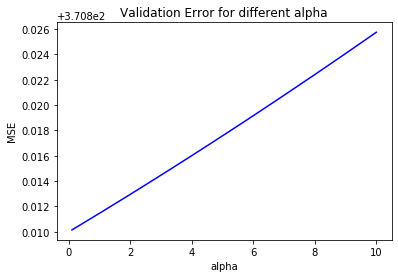

In [39]:
import matplotlib.pyplot as plt
%matplotlib inline

plt.title("Validation Error for different alpha")
plt.xlabel("alpha")
plt.ylabel("MSE")

alphas = np.linspace(start=0.1, stop=10, num=100)

mses = []

for alpha in alphas:
    reg_model = linear_model.Ridge(alpha = alpha).fit(X_train_2, y_train_2)
    mse = metrics.mean_squared_error(reg_model.predict(X_valid), y_valid)
    mses.append(mse)

plt.plot(alphas, mses, 'b-')

plt.show()

In [40]:
# Performing LASSO Regression 
from sklearn import preprocessing
# Standardizing the features
X = StandardScaler().fit_transform(X)
#split the dataset into train and test set
# Separating out the features
X = df[features]
# Separating out the target
y = df[['risk_infection']]
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

X_train_scale = X_train[features].values
y_train = y_train['risk_infection'].values
X_test_scale = X_test[features].values
y_test = y_test['risk_infection'].values

In [41]:
reg_lasso_CV = linear_model.LassoCV(eps = None, 
                                    n_alphas = None, 
                                    alphas=[0.1, 1.0, 10.0], 
                                    cv=5)
reg_lasso_CV.fit(X_train_scale, y_train)

LassoCV(alphas=[0.1, 1.0, 10.0], copy_X=True, cv=5, eps=None,
        fit_intercept=True, max_iter=1000, n_alphas=None, n_jobs=None,
        normalize=False, positive=False, precompute='auto', random_state=None,
        selection='cyclic', tol=0.0001, verbose=False)

In [42]:
# Using hold-out approach
reg_lasso_CV_2 = linear_model.LassoCV(eps = 0.001, 
                                      n_alphas = 100, 
                                      cv=5)
reg_lasso_CV_2.fit(X_train_scale, y_train)

LassoCV(alphas=None, copy_X=True, cv=5, eps=0.001, fit_intercept=True,
        max_iter=1000, n_alphas=100, n_jobs=None, normalize=False,
        positive=False, precompute='auto', random_state=None,
        selection='cyclic', tol=0.0001, verbose=False)

In [43]:
print("Alpha is: {0}".format(reg_lasso_CV_2.alpha_))

print("Coefficients are: {0}".format(reg_lasso_CV_2.coef_))

print("Intercept is: {0}".format(reg_lasso_CV_2.intercept_))

prediction = reg_lasso_CV_2.predict(X_test_scale[0:1])

print("Prediction for first house in test dataset: {0}".format(prediction))

Alpha is: 0.2867620701188768
Coefficients are: [-0.00000000e+00  4.08479746e-01 -1.69203284e-01  6.17582397e+00
 -5.39833472e+00  0.00000000e+00  1.35312362e+01  1.37495589e+01
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -0.00000000e+00
 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
 -0.00000000e+00 -2.06132034e-03]
Intercept is: 49.29383495248625
Prediction for first house in test dataset: [72.32814398]


In [44]:
labelled_coeffs_dict = {'labels' : features,
                    'coefficient LASSO': reg_lasso_CV_2.coef_}

labelled_coeffs_frame = pd.DataFrame(labelled_coeffs_dict)

labelled_coeffs_frame

,labels,coefficient LASSO
0,sex,-0.000000
1,smoking,0.408480
2,alcohol,-0.169203
3,contacts_count,6.175824
4,rate_reducing_mask,-5.398335
5,covid19_positive,0.000000
6,covid19_symptoms,13.531236
7,covid19_contact,13.749559
8,asthma,0.000000
9,kidney_disease,0.000000


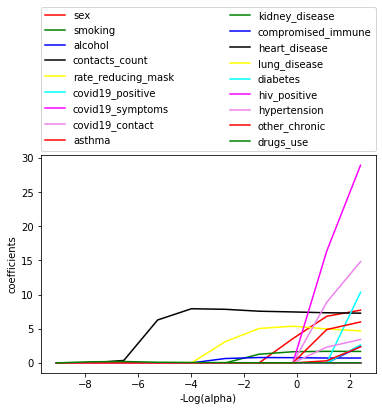

In [45]:
import matplotlib.cm as cm

alphas_lasso, coeffs_lasso, _ = linear_model.lasso_path(X_train_scale, y_train, 
                                                        eps = 0.00001, n_alphas = 10, cv=5)

plt.xlabel("-Log(alpha)")
plt.ylabel("coefficients")

ax = plt.gca()

ax.set_prop_cycle(color=['red', 'green', 'blue', 'black', 'yellow', 'cyan', 'magenta', 'violet'])

plt.plot(-np.log(alphas_lasso), coeffs_lasso.T)

plt.legend(labels = features, bbox_to_anchor=(0., 1.02, 1., .102), loc="best",
           ncol=2, mode="expand", borderaxespad=0.)
plt.show()

In [46]:
correlation_matrix = pd.DataFrame(np.corrcoef(X_train, rowvar = 0))

#rowvar = 0 to as rows relate to different records, columns to variables

#To label the different features:

correlation_matrix.columns = features
correlation_matrix.index = features

correlation_matrix

,sex,smoking,alcohol,contacts_count,rate_reducing_mask,covid19_positive,covid19_symptoms,covid19_contact,asthma,kidney_disease,compromised_immune,heart_disease,lung_disease,diabetes,hiv_positive,hypertension,other_chronic,drugs_use
sex,1.000000,0.029140,0.095019,-0.003440,-0.054090,0.011237,-0.010368,-0.018148,-0.061815,0.010820,-0.073292,0.059612,0.010136,0.038168,0.064176,0.072164,-0.061595,0.067605
smoking,0.029140,1.000000,0.078155,0.071527,-0.033698,-0.006981,0.014671,-0.013559,-0.001347,0.008292,0.028375,0.024927,0.081441,0.011546,0.018640,0.009733,0.024592,0.307132
alcohol,0.095019,0.078155,1.000000,-0.008040,-0.035721,-0.003945,-0.004530,0.005968,-0.027810,-0.012103,-0.048910,-0.011971,-0.011300,-0.068162,0.010269,-0.006918,-0.051483,0.099868
contacts_count,-0.003440,0.071527,-0.008040,1.000000,-0.080103,0.004548,0.023851,0.178725,0.001795,-0.003684,-0.021298,-0.023126,-0.020170,-0.015817,-0.005535,-0.013684,-0.024362,0.016946
rate_reducing_mask,-0.054090,-0.033698,-0.035721,-0.080103,1.000000,0.007946,-0.001301,0.048981,0.029395,0.010255,0.043595,0.017605,0.023693,0.021761,0.005259,0.034225,0.044644,-0.018439
covid19_positive,0.011237,-0.006981,-0.003945,0.004548,0.007946,1.000000,0.096761,0.053661,0.000466,0.009933,0.004933,0.007177,0.003816,0.007395,0.005516,0.005640,0.004777,-0.003512
covid19_symptoms,-0.010368,0.014671,-0.004530,0.023851,-0.001301,0.096761,1.000000,0.097543,0.033543,0.009429,0.041310,0.002390,0.009288,0.004108,0.001656,0.001839,0.040788,0.015898
covid19_contact,-0.018148,-0.013559,0.005968,0.178725,0.048981,0.053661,0.097543,1.000000,0.008510,0.001723,0.003270,-0.006389,-0.003903,-0.010225,0.002125,-0.008689,0.005906,-0.017260
asthma,-0.061815,-0.001347,-0.027810,0.001795,0.029395,0.000466,0.033543,0.008510,1.000000,0.012102,0.092527,0.008214,0.063765,0.023335,-0.001935,0.018852,0.086071,0.035553
kidney_disease,0.010820,0.008292,-0.012103,-0.003684,0.010255,0.009933,0.009429,0.001723,0.012102,1.000000,0.071907,0.078967,0.051631,0.056875,0.011650,0.065304,0.042026,0.002785


In [47]:
## Perform Elastic net regression 5-fold cross-validation 

reg_elastic_net_CV = linear_model.ElasticNetCV(eps = None, n_alphas = None, 
                                               alphas=[0.1, 1.0, 10.0], 
                                               l1_ratio = [0.1, 0.5, 0.7, 0.9, 0.95, 0.99, 1.0],
                                               cv=5)
reg_elastic_net_CV.fit(X_train_scale, y_train)

ElasticNetCV(alphas=[0.1, 1.0, 10.0], copy_X=True, cv=5, eps=None,
             fit_intercept=True, l1_ratio=[0.1, 0.5, 0.7, 0.9, 0.95, 0.99, 1.0],
             max_iter=1000, n_alphas=None, n_jobs=None, normalize=False,
             positive=False, precompute='auto', random_state=None,
             selection='cyclic', tol=0.0001, verbose=0)

In [48]:
print("Alpha is: {0}".format(reg_elastic_net_CV.alpha_))

print("Grid of alphas used is: {0}".format(reg_elastic_net_CV.alphas_))

print("L1 ratio is: {0}".format(reg_elastic_net_CV.l1_ratio_))

print("Coefficients are: {0}".format(reg_elastic_net_CV.coef_))

print("Intercept is: {0}".format(reg_elastic_net_CV.intercept_))

prediction = reg_elastic_net_CV.predict(X_test_scale[0:1])

print("Prediction for first house in test dataset: {0}".format(prediction))

Alpha is: 0.1
Grid of alphas used is: [10.   1.   0.1]
L1 ratio is: 1.0
Coefficients are: [-4.83721623e-01  4.47295308e-01 -1.77918910e-01  6.14735195e+00
 -5.57686945e+00  1.92742870e+00  2.43168830e+01  1.85594795e+01
  0.00000000e+00  0.00000000e+00 -0.00000000e+00 -0.00000000e+00
 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
 -0.00000000e+00 -2.16567926e-03]
Intercept is: 49.70333195283733
Prediction for first house in test dataset: [72.29139455]


In [49]:
labelled_coeffs_dict = {'labels' : features,
                    'coefficient Elastic net': reg_elastic_net_CV.coef_}

labelled_coeffs_frame = pd.DataFrame(labelled_coeffs_dict)

labelled_coeffs_frame

,labels,coefficient Elastic net
0,sex,-0.483722
1,smoking,0.447295
2,alcohol,-0.177919
3,contacts_count,6.147352
4,rate_reducing_mask,-5.576869
5,covid19_positive,1.927429
6,covid19_symptoms,24.316883
7,covid19_contact,18.559480
8,asthma,0.000000
9,kidney_disease,0.000000


#### Best subset selection method 
Because of the size of our dataset, it will be computationally expensive to run this approach using the entire data, thus we sample out from the dataset, in order to perform this approach. 


In [50]:
import itertools
import time
import numpy as np
import pandas as pd
import seaborn as sns
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn import linear_model
from sklearn.metrics import mean_squared_error

%matplotlib inline
plt.style.use('ggplot')

In [52]:
# define the sample set  
df_sample = df.sample(n = 684)  
features = ['sex', 'smoking', 'alcohol', 'contacts_count', 'rate_reducing_mask',
                         'covid19_positive', 'covid19_symptoms', 'covid19_contact', 'asthma',
                         'kidney_disease', 'compromised_immune', 'heart_disease', 'lung_disease', 
                         'diabetes', 'hiv_positive', 'hypertension', 'other_chronic', 'drugs_use']

#split the dataset into train and test set
# Separating out the features
X = df_sample[features]
# Separating out the target
y = df_sample[['risk_infection']]

Index(['numb_features', 'RSS', 'R_squared', 'features'], dtype='object')

In [53]:
def fit_linear_reg(X,y):
    #Fit linear regression model and return RSS and R squared values
    model_k = linear_model.LinearRegression(fit_intercept = True)
    model_k.fit(X,y)
    RSS = mean_squared_error(y,model_k.predict(X)) * len(y)
    R_squared = model_k.score(X,y)
    return RSS, R_squared

In [54]:
#Importing tqdm for the progress bar
from tqdm import tnrange, tqdm_notebook
k = 18
RSS_list, R_squared_list, feature_list = [],[], []
numb_features = []

#Looping over k = 1 to k = 18 features in X
for k in tnrange(1,len(X.columns) + 1, desc = 'Loop...'):

    #Looping over all possible combinations: from 18 choose k
    for combo in itertools.combinations(X.columns,k):
        tmp_result = fit_linear_reg(X[list(combo)],y)   #Store temp result 
        RSS_list.append(tmp_result[0])                  #Append lists
        R_squared_list.append(tmp_result[1])
        feature_list.append(combo)
        numb_features.append(len(combo))   

#Store in DataFrame
df = pd.DataFrame({'numb_features': numb_features,'RSS': RSS_list, 'R_squared':R_squared_list,'features':feature_list})

In [59]:
#Store in DataFrame
df_sample = pd.DataFrame({'numb_features': numb_features,'RSS': RSS_list, 'R_squared':R_squared_list,'features':feature_list})

In [61]:
df_min = df_sample[df_sample.groupby('numb_features')['RSS'].transform(min) == df_sample['RSS']]
df_max = df_sample[df_sample.groupby('numb_features')['R_squared'].transform(max) == df_sample['R_squared']]
display(df_min.head(3))
display(df_max.head(3))

,numb_features,RSS,R_squared,features
3,1,302988.535616,0.808621,"(contacts_count,)"
66,2,270369.654336,0.829224,"(contacts_count, rate_reducing_mask)"
534,3,251487.098290,0.841151,"(contacts_count, rate_reducing_mask, covid19_c..."


,numb_features,RSS,R_squared,features
3,1,302988.535616,0.808621,"(contacts_count,)"
66,2,270369.654336,0.829224,"(contacts_count, rate_reducing_mask)"
534,3,251487.098290,0.841151,"(contacts_count, rate_reducing_mask, covid19_c..."


In [67]:
df_sample['min_RSS'] = df_sample.groupby('numb_features')['RSS'].transform(min)
df_sample['max_R_squared'] = df_sample.groupby('numb_features')['R_squared'].transform(max)
df_sample.head(50)

,numb_features,RSS,R_squared,features,min_RSS,max_R_squared
0,1,1.581836e+06,0.000853,"(sex,)",302988.535616,0.808621
1,1,1.529873e+06,0.033675,"(smoking,)",302988.535616,0.808621
2,1,1.582909e+06,0.000176,"(alcohol,)",302988.535616,0.808621
3,1,3.029885e+05,0.808621,"(contacts_count,)",302988.535616,0.808621
4,1,1.518196e+06,0.041051,"(rate_reducing_mask,)",302988.535616,0.808621
5,1,1.583188e+06,0.000000,"(covid19_positive,)",302988.535616,0.808621
6,1,1.572756e+06,0.006589,"(covid19_symptoms,)",302988.535616,0.808621
7,1,1.495825e+06,0.055181,"(covid19_contact,)",302988.535616,0.808621
8,1,1.582285e+06,0.000570,"(asthma,)",302988.535616,0.808621
9,1,1.582566e+06,0.000392,"(kidney_disease,)",302988.535616,0.808621


C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


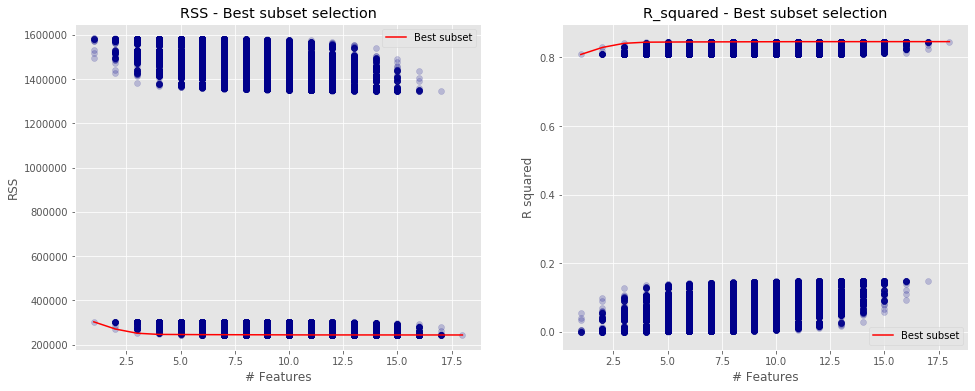

In [63]:
## Plotting the best subset selection 

fig = plt.figure(figsize = (16,6))
ax = fig.add_subplot(1, 2, 1)

ax.scatter(df_sample.numb_features,df.RSS, alpha = .2, color = 'darkblue' )
ax.set_xlabel('# Features')
ax.set_ylabel('RSS')
ax.set_title('RSS - Best subset selection')
ax.plot(df_sample.numb_features,df_sample.min_RSS,color = 'r', label = 'Best subset')
ax.legend()

ax = fig.add_subplot(1, 2, 2)
ax.scatter(df_sample.numb_features,df_sample.R_squared, alpha = .2, color = 'darkblue' )
ax.plot(df_sample.numb_features,df_sample.max_R_squared,color = 'r', label = 'Best subset')
ax.set_xlabel('# Features')
ax.set_ylabel('R squared')
ax.set_title('R_squared - Best subset selection')
ax.legend()

plt.show()


In [69]:
## Performing best forward subset selection 

k = 18

remaining_features = list(X.columns.values)
features = []
RSS_list, R_squared_list = [np.inf], [np.inf] #Due to 1 indexing of the loop...
features_list = dict()

for i in range(1,k+1):
    best_RSS = np.inf
    
    for combo in itertools.combinations(remaining_features,1):

            RSS = fit_linear_reg(X[list(combo) + features],y)   #Store temp result 

            if RSS[0] < best_RSS:
                best_RSS = RSS[0]
                best_R_squared = RSS[1] 
                best_feature = combo[0]

    #Updating variables for next loop
    features.append(best_feature)
    remaining_features.remove(best_feature)
    
    #Saving values for plotting
    RSS_list.append(best_RSS)
    R_squared_list.append(best_R_squared)
    features_list[i] = features.copy()

In [70]:
print('Forward stepwise subset selection')
print('Number of features |', 'Features |', 'RSS')
display([(i,features_list[i], round(RSS_list[i])) for i in range(1,5)])

Forward stepwise subset selection
Number of features | Features | RSS


[(1, ['contacts_count'], 302989.0),
 (2, ['contacts_count', 'rate_reducing_mask'], 270370.0),
 (3, ['contacts_count', 'rate_reducing_mask', 'covid19_contact'], 251487.0),
 (4,
  ['contacts_count',
   'rate_reducing_mask',
   'covid19_contact',
   'covid19_symptoms'],
  246171.0)]

In [71]:
df1 = pd.concat([pd.DataFrame({'features':features_list}),pd.DataFrame({'RSS':RSS_list, 'R_squared': R_squared_list})], axis=1, join='inner')
df1['numb_features'] = df1.index

In [73]:
### Computing the C_p, AIC, BIC and R-square adjusted

#Initializing useful variables
m = len(y)
p = 18
hat_sigma_squared = (1/(m - p -1)) * min(df1['RSS'])

#Computing
df1['C_p'] = (1/m) * (df1['RSS'] + 2 * df1['numb_features'] * hat_sigma_squared )
df1['AIC'] = (1/(m*hat_sigma_squared)) * (df1['RSS'] + 2 * df1['numb_features'] * hat_sigma_squared )
df1['BIC'] = (1/(m*hat_sigma_squared)) * (df1['RSS'] +  np.log(m) * df1['numb_features'] * hat_sigma_squared )
df1['R_squared_adj'] = 1 - ( (1 - df1['R_squared'])*(m-1)/(m-df1['numb_features'] -1))
df1

,features,RSS,R_squared,numb_features,C_p,AIC,BIC,R_squared_adj
1,[contacts_count],302988.535616,0.808621,1,444.036915,1.212033,1.218653,0.808341
2,"[contacts_count, rate_reducing_mask]",270369.654336,0.829224,2,397.419712,1.084787,1.098027,0.828723
3,"[contacts_count, rate_reducing_mask, covid19_c...",251487.098290,0.841151,3,370.884856,1.012359,1.032218,0.840451
4,"[contacts_count, rate_reducing_mask, covid19_c...",246171.236132,0.844509,4,364.184348,0.994069,1.020548,0.843593
5,"[contacts_count, rate_reducing_mask, covid19_c...",245514.724043,0.844924,5,364.295755,0.994373,1.027472,0.843780
6,"[contacts_count, rate_reducing_mask, covid19_c...",245141.151594,0.845160,6,364.820816,0.995806,1.035525,0.843787
7,"[contacts_count, rate_reducing_mask, covid19_c...",244777.086556,0.845390,7,365.359777,0.997277,1.043616,0.843789
8,"[contacts_count, rate_reducing_mask, covid19_c...",244488.381799,0.845572,8,366.008914,0.999049,1.052008,0.843742
9,"[contacts_count, rate_reducing_mask, covid19_c...",244199.191855,0.845755,9,366.657342,1.000819,1.060398,0.843695
10,"[contacts_count, rate_reducing_mask, covid19_c...",244003.160389,0.845879,10,367.441966,1.002961,1.069159,0.843588


In [74]:
df1['R_squared_adj'].idxmax()
df1['R_squared_adj'].max()

0.8437887133279504

## Plotting the computed values as a function of number of features

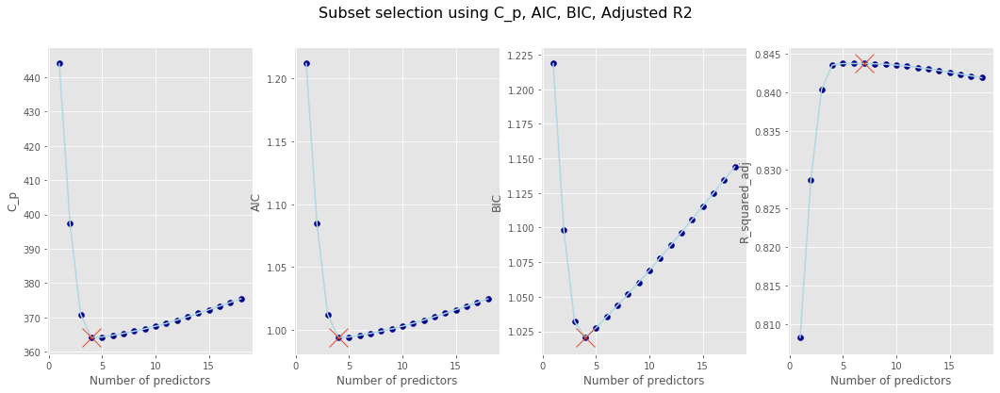

In [75]:
variables = ['C_p', 'AIC','BIC','R_squared_adj']
fig = plt.figure(figsize = (18,6))

for i,v in enumerate(variables):
    ax = fig.add_subplot(1, 4, i+1)
    ax.plot(df1['numb_features'],df1[v], color = 'lightblue')
    ax.scatter(df1['numb_features'],df1[v], color = 'darkblue')
    if v == 'R_squared_adj':
        ax.plot(df1[v].idxmax(),df1[v].max(), marker = 'x', markersize = 20)
    else:
        ax.plot(df1[v].idxmin(),df1[v].min(), marker = 'x', markersize = 20)
    ax.set_xlabel('Number of predictors')
    ax.set_ylabel(v)

fig.suptitle('Subset selection using C_p, AIC, BIC, Adjusted R2', fontsize = 16)
plt.show()

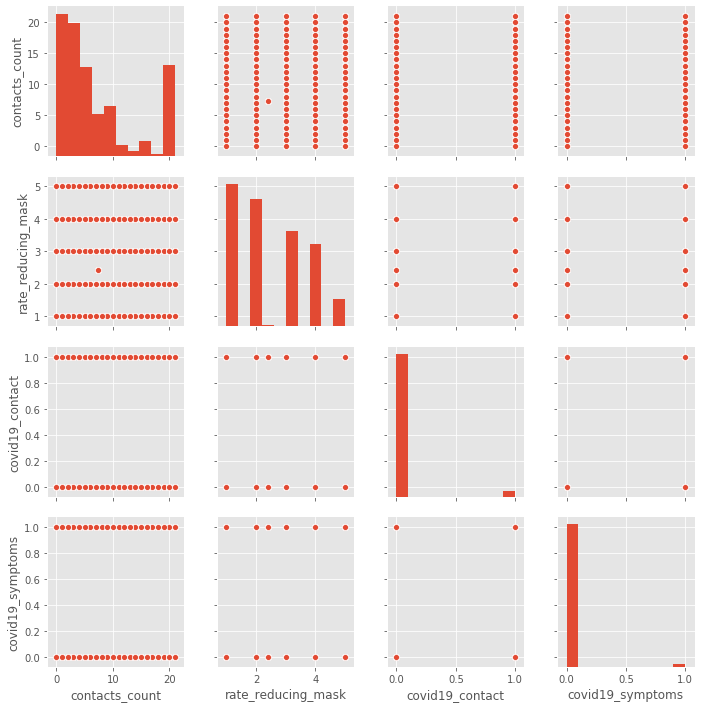

In [89]:
sns.pairplot(df[['contacts_count','rate_reducing_mask','covid19_contact','covid19_symptoms']]);

In [21]:
column3drop = ['sex', 'smoking', 'alcohol', 'covid19_positive', 'asthma','house_count',
               'country', 'age', 'bmi', 'blood_type','text_working', 'rate_government_action', 
               'rate_reducing_risk_single', 'rate_reducing_risk_house','opinion_infection',
                         'kidney_disease', 'compromised_immune', 'heart_disease', 'lung_disease', 
                         'diabetes', 'hiv_positive', 'hypertension', 'other_chronic', 'drugs_use']
df.drop(column3drop, axis=1, inplace=True)

In [23]:
column3drop = ['region','prescription_medication']
df.drop(column3drop, axis=1, inplace=True)

In [24]:
df.columns

Index(['contacts_count', 'rate_reducing_mask', 'covid19_symptoms',
       'covid19_contact', 'risk_infection'],
      dtype='object')

In [25]:
### perform OLS regression using the four best features selected by Best Forward subset approach 
#df_1.info()
features = ['contacts_count', 'rate_reducing_mask', 'covid19_symptoms',
       'covid19_contact']

#split the dataset into train and test set
# Separating out the features
X = df[features]
# Separating out the target
y = df['risk_infection']

In [26]:
# Split your data set into 80/20 for train/test datasets
import statsmodels.api as sm
from sklearn import metrics 
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=.80,
random_state=1)
# create a fitted model & print the summary
lm = sm.OLS(y_train, X_train).fit()
print(lm.summary())
# make predictions on the testing set
y_train_pred = lm.predict(X_train)
y_test_pred = lm.predict(X_test)
print("Train MAE: ", metrics.mean_absolute_error(y_train, y_train_pred))
print("Train RMSE: ", np.sqrt(metrics.mean_squared_error(y_train, y_train_pred)))
print("Test MAE: ", metrics.mean_absolute_error(y_test, y_test_pred))
print("Test RMSE: ", np.sqrt(metrics.mean_squared_error(y_test, y_test_pred)))

                                 OLS Regression Results                                
Dep. Variable:         risk_infection   R-squared (uncentered):                   0.916
Model:                            OLS   Adj. R-squared (uncentered):              0.916
Method:                 Least Squares   F-statistic:                          1.485e+06
Date:                Fri, 12 Jun 2020   Prob (F-statistic):                        0.00
Time:                        17:29:20   Log-Likelihood:                     -2.5886e+06
No. Observations:              546234   AIC:                                  5.177e+06
Df Residuals:                  546230   BIC:                                  5.177e+06
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
                         coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------

#### Preparing dataset for Machine learning 

Preparing dataset for Supervised Machine algorithms using the features identified from best subset selection 

In [80]:
#reading the file using dask
import dask.dataframe as dd
%time df = pd.read_csv("master_dataset.csv")

# Filling Missing observations in Continuous variables in the dataset:
df['rate_reducing_mask'].fillna(df['rate_reducing_mask'].mean(), inplace=True)
# Filling Missing observations in Continuous variables in the dataset:
df['contacts_count'].fillna(df['contacts_count'].mean(), inplace=True)
df['covid19_symptoms'].fillna(df['covid19_symptoms'].mean(), inplace=True)
df['covid19_contact'].fillna(df['covid19_contact'].mean(), inplace=True)

#df['bmi'].fillna(df['bmi'].mean(), inplace=True)
df['risk_infection'].fillna(df['risk_infection'].mean(), inplace=True)

Wall time: 3.45 s


In [81]:
# binarize the percentage risk infection to risk status
df['risk_infection'] = pd.cut(df.risk_infection,bins=[0,34,67,100],labels=['Low','Medium','High'])
df['risk_infection']

0            Low
1            Low
2            Low
3            Low
4            Low
           ...  
682788      High
682789       Low
682790       Low
682791       Low
682792    Medium
Name: risk_infection, Length: 682793, dtype: category
Categories (3, object): [Low < Medium < High]

In [82]:
df.columns

Index(['region', 'country', 'sex', 'age', 'bmi', 'blood_type', 'smoking',
       'alcohol', 'cannabis', 'amphetamines', 'cocaine', 'lsd', 'mdma',
       'contacts_count', 'house_count', 'text_working',
       'rate_government_action', 'rate_reducing_risk_single',
       'rate_reducing_risk_house', 'rate_reducing_mask', 'covid19_positive',
       'covid19_symptoms', 'covid19_contact', 'asthma', 'kidney_disease',
       'compromised_immune', 'heart_disease', 'lung_disease', 'diabetes',
       'hiv_positive', 'hypertension', 'other_chronic',
       'prescription_medication', 'opinion_infection', 'opinion_mortality',
       'risk_infection', 'risk_mortality'],
      dtype='object')

In [83]:
column3drop = ['region', 'country', 'sex', 'age', 'bmi', 'blood_type', 'smoking',
       'alcohol', 'cannabis', 'amphetamines', 'cocaine', 'lsd', 'mdma',
       'house_count', 'text_working',
       'rate_government_action', 'rate_reducing_risk_single',
       'rate_reducing_risk_house',  'covid19_positive',
       'asthma', 'kidney_disease',
       'compromised_immune', 'heart_disease', 'lung_disease', 'diabetes',
       'hiv_positive', 'hypertension', 'other_chronic',
       'prescription_medication', 'opinion_infection', 'opinion_mortality', 'risk_mortality']
df.drop(column3drop, axis=1, inplace=True)

In [84]:
from sklearn.preprocessing import LabelEncoder
label_encoders = dict()
column2encode = ['risk_infection']

for col in column2encode:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])
    label_encoders[col] = le

In [85]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing

In [86]:
## Split data set into training, validation and testing 
attributes = [col for col in df.columns if col != 'risk_infection']
X = df[attributes].values
y = df.risk_infection
scaler = preprocessing.StandardScaler().fit(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

In [87]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn import svm
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from sklearn import metrics
from sklearn.model_selection import cross_val_score
from scipy import interp
from sklearn.metrics import roc_auc_score

In [88]:

# k = 5 for Logistics Classifier
##from sklearn import metrics
#from sklearn.model_selection import cross_val_score
%time logreg = LogisticRegression(random_state = 0, multi_class = 'auto', solver = 'lbfgs', max_iter = 100).fit(X_train,y_train)

# Use cross_val_score function
# We are passing the entirety of X and y, not X_train or y_train, it takes care of splitting the dat
# cv=10 for 10 folds
# scoring='accuracy' for evaluation metric
scores = cross_val_score(logreg, X_train, y_train, cv=10, scoring='accuracy')
print(scores)

C:\Users\Hp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


Wall time: 32.4 s


C:\Users\Hp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)
C:\Users\Hp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regressio

[0.81931019 0.82178163 0.81808363 0.81909051 0.8178423  0.82119254
 0.81837321 0.81976457 0.82093624 0.81905058]


C:\Users\Hp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


In [89]:
%time y_pred = logreg.predict(X_test)
%time y_pred_tr = logreg.predict(X_train)

Wall time: 12.6 ms
Wall time: 45.1 ms


In [90]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, f1_score, classification_report
from sklearn.metrics import roc_curve, auc, roc_auc_score

print('Train Accuracy %s' % accuracy_score(y_train, y_pred_tr))
print('Train F1-score %s' % f1_score(y_train, y_pred_tr, average=None))
print(classification_report(y_train, y_pred_tr))
confusion_matrix(y_train, y_pred_tr)
print()

print('Test Accuracy %s' % accuracy_score(y_test, y_pred))
print('Test F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))
confusion_matrix(y_test, y_pred)

Train Accuracy 0.8195169103351311
Train F1-score [0.87837545 0.75047524 0.8149099 ]
              precision    recall  f1-score   support

           0       0.90      0.86      0.88    165103
           1       0.76      0.75      0.75    120687
           2       0.80      0.83      0.81    260444

    accuracy                           0.82    546234
   macro avg       0.82      0.81      0.81    546234
weighted avg       0.82      0.82      0.82    546234


Test Accuracy 0.8180639869946323
Test F1-score [0.87829574 0.74785129 0.81314628]
              precision    recall  f1-score   support

           0       0.90      0.86      0.88     41224
           1       0.75      0.74      0.75     30230
           2       0.80      0.83      0.81     65105

    accuracy                           0.82    136559
   macro avg       0.82      0.81      0.81    136559
weighted avg       0.82      0.82      0.82    136559



array([[35477,    87,  5660],
       [   38, 22449,  7743],
       [ 4047,  7270, 53788]], dtype=int64)

Wall time: 0 ns


Text(0.5, 21.5, 'Predicted label')

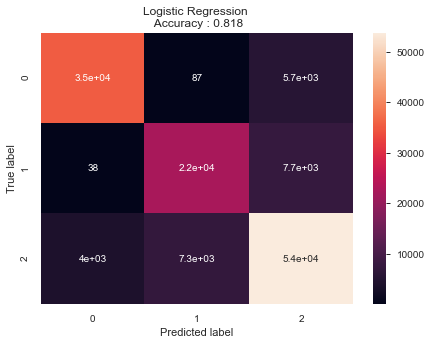

In [91]:
%time
import seaborn as sns
confusion = confusion_matrix(y_test, y_pred)
df1 = pd.DataFrame(confusion)
plt.figure(figsize = (7, 5))
sns.heatmap(df1, annot = True)
plt.title('Logistic Regression \n Accuracy : {0:.3f}'.format(accuracy_score(y_test, y_pred)))
plt.ylabel('True label')
plt.xlabel('Predicted label')

#### Decision tree classifier 

In [92]:

clf = DecisionTreeClassifier(criterion='gini', max_depth=6, min_samples_split=2, min_samples_leaf=5)
%time clf = clf.fit(X_train, y_train)

# scoring='accuracy' for evaluation metric - althought they are many
scores = cross_val_score(clf, X_train, y_train, cv=10, scoring='accuracy')
print(scores)

Wall time: 624 ms
[0.82978178 0.83174063 0.82934241 0.82981839 0.82791132 0.832122
 0.83034619 0.82933929 0.82963221 0.82988851]


In [93]:
%time y_pred = clf.predict(X_test)
%time y_pred_tr = clf.predict(X_train)

Wall time: 23.6 ms
Wall time: 89.1 ms


In [94]:
print('Train Accuracy %s' % accuracy_score(y_train, y_pred_tr))
print('Train F1-score %s' % f1_score(y_train, y_pred_tr, average=None))
print(classification_report(y_train, y_pred_tr))
confusion_matrix(y_train, y_pred_tr)
print()

print('Test Accuracy %s' % accuracy_score(y_test, y_pred))
print('Test F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))
confusion_matrix(y_test, y_pred)

Train Accuracy 0.8299977665249691
Train F1-score [0.87254371 0.78681524 0.82469764]
              precision    recall  f1-score   support

           0       0.91      0.84      0.87    165103
           1       0.77      0.81      0.79    120687
           2       0.82      0.83      0.82    260444

    accuracy                           0.83    546234
   macro avg       0.83      0.83      0.83    546234
weighted avg       0.83      0.83      0.83    546234


Test Accuracy 0.8305860470565836
Test F1-score [0.87337201 0.78806095 0.82484612]
              precision    recall  f1-score   support

           0       0.91      0.84      0.87     41224
           1       0.77      0.81      0.79     30230
           2       0.82      0.83      0.82     65105

    accuracy                           0.83    136559
   macro avg       0.83      0.83      0.83    136559
weighted avg       0.83      0.83      0.83    136559



array([[34703,   114,  6407],
       [    0, 24515,  5715],
       [ 3542,  7357, 54206]], dtype=int64)

Text(0.5, 21.5, 'Predicted label')

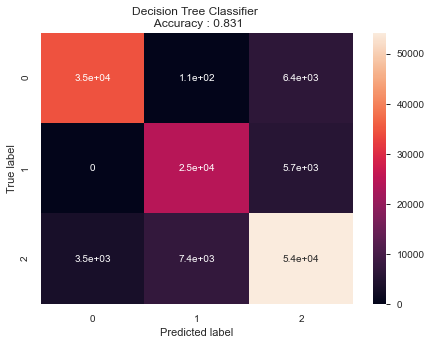

In [95]:
import seaborn as sns
confusion = confusion_matrix(y_test, y_pred)
df1 = pd.DataFrame(confusion)
plt.figure(figsize = (7, 5))
sns.heatmap(df1, annot = True)
plt.title('Decision Tree Classifier \n Accuracy : {0:.3f}'.format(accuracy_score(y_test, y_pred)))
plt.ylabel('True label')
plt.xlabel('Predicted label')

In [96]:
for col, imp in zip(attributes, clf.feature_importances_):
    print(col, imp)

contacts_count 0.904259080323126
rate_reducing_mask 0.05985667649935762
covid19_symptoms 0.009760540772780615
covid19_contact 0.02612370240473572


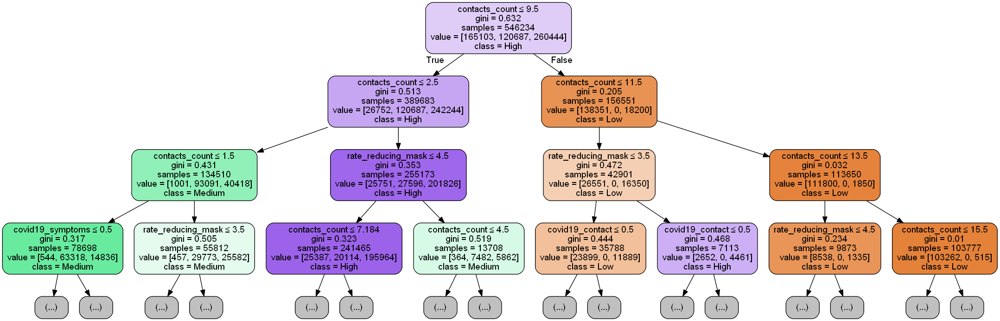

<Figure size 864x864 with 0 Axes>

In [97]:
import pydotplus
from sklearn import tree
from IPython.display import Image
dot_data = tree.export_graphviz(clf, out_file=None,
                                feature_names=attributes,
                                class_names=['Low', 'Medium', 'High'],  
                                filled=True, rounded=True,  
                                special_characters=True,
                                max_depth=3)  
graph = pydotplus.graph_from_dot_data(dot_data)
plt.figure(figsize = (12,12))
Image(graph.create_png())

In [98]:
# Calculate feature importances
importances = clf.feature_importances_

In [99]:
feature_names = ['contacts_count','rate_reducing_mask', 'covid19_symptoms', 'covid19_contact']

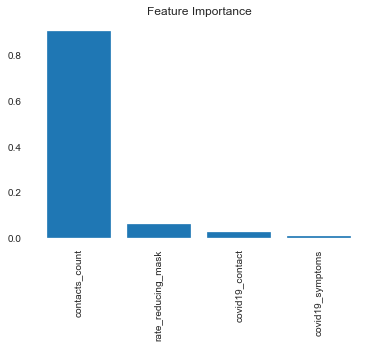

In [100]:
# Sort feature importances in descending order
indices = np.argsort(importances)[::-1]

# Rearrange feature names so they match the sorted feature importances
names = [feature_names[i] for i in indices]

# Create plot
plt.figure()

# Create plot title
plt.title("Feature Importance")

# Add bars
plt.bar(range(X.shape[1]), importances[indices])

# Add feature names as x-axis labels
plt.xticks(range(X.shape[1]), names, rotation=90)

# Show plot
plt.show()

In [101]:
def report(results, n_top=3):
    for i in range(1, n_top + 1):
        candidates = np.flatnonzero(results['rank_test_score'] == i)
        for candidate in candidates:
            print("Model with rank: {0}".format(i))
            print("Mean validation score: {0:.3f} (std: {1:.3f})".format(
                  results['mean_test_score'][candidate],
                  results['std_test_score'][candidate]))
            print("Parameters: {0}".format(results['params'][candidate]))
            print("")

In [102]:
from sklearn.ensemble import RandomForestClassifier
param_list = {'max_depth': [None] + list(np.arange(2, 50)),
              'min_samples_split': [2, 5, 10, 15, 20],
              'min_samples_leaf': [1, 5, 10, 15, 20],
              'criterion': ['gini', 'entropy'],
             }

clf = RandomForestClassifier(n_estimators=10, criterion='gini', max_depth=None, 
                             min_samples_split=2, min_samples_leaf=1, class_weight=None)

random_search = RandomizedSearchCV(clf, param_distributions=param_list, n_iter=10)
%time random_search.fit(X_train, y_train)
report(random_search.cv_results_, n_top=3)

Wall time: 3min 23s
Model with rank: 1
Mean validation score: 0.834 (std: 0.001)
Parameters: {'min_samples_split': 15, 'min_samples_leaf': 5, 'max_depth': 18, 'criterion': 'gini'}

Model with rank: 2
Mean validation score: 0.834 (std: 0.001)
Parameters: {'min_samples_split': 20, 'min_samples_leaf': 5, 'max_depth': 47, 'criterion': 'entropy'}

Model with rank: 3
Mean validation score: 0.834 (std: 0.001)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 5, 'max_depth': 27, 'criterion': 'gini'}



In [103]:
%time
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
y_pred_tr = clf.predict(X_train)

Wall time: 0 ns


In [104]:

print('Train Accuracy %s' % accuracy_score(y_train, y_pred_tr))
print('Train F1-score %s' % f1_score(y_train, y_pred_tr, average=None))
print(classification_report(y_train, y_pred_tr))
confusion_matrix(y_train, y_pred_tr)
print()

print('Test Accuracy %s' % accuracy_score(y_test, y_pred))
print('Test F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))
confusion_matrix(y_test, y_pred)

Train Accuracy 0.8338441034428469
Train F1-score [0.88017912 0.7885544  0.82652973]
              precision    recall  f1-score   support

           0       0.90      0.86      0.88    165103
           1       0.77      0.81      0.79    120687
           2       0.83      0.83      0.83    260444

    accuracy                           0.83    546234
   macro avg       0.83      0.83      0.83    546234
weighted avg       0.84      0.83      0.83    546234


Test Accuracy 0.8340936884423582
Test F1-score [0.88054515 0.78962202 0.82633034]
              precision    recall  f1-score   support

           0       0.89      0.87      0.88     41224
           1       0.77      0.81      0.79     30230
           2       0.83      0.82      0.83     65105

    accuracy                           0.83    136559
   macro avg       0.83      0.83      0.83    136559
weighted avg       0.84      0.83      0.83    136559



array([[35729,   101,  5394],
       [    0, 24515,  5715],
       [ 4199,  7247, 53659]], dtype=int64)

Text(0.5, 21.5, 'Predicted label')

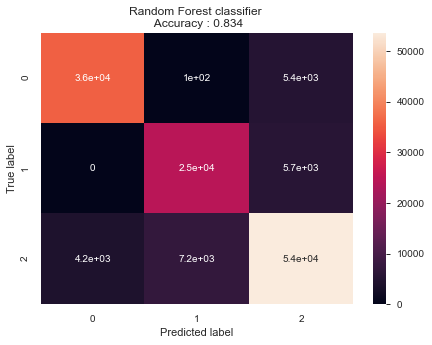

In [105]:
import seaborn as sns
confusion = confusion_matrix(y_test, y_pred)
df1 = pd.DataFrame(confusion)
plt.figure(figsize = (7, 5))
sns.heatmap(df1, annot = True)
plt.title('Random Forest classifier \n Accuracy : {0:.3f}'.format(accuracy_score(y_test, y_pred)))
plt.ylabel('True label')
plt.xlabel('Predicted label')

In [106]:
%time
from sklearn.multiclass import OneVsRestClassifier
from sklearn.datasets import make_classification

model = KNeighborsClassifier()
%time model.fit(X_train, y_train)

%time y_predict = model.predict(X_test)

confusion_matrix(y_test, y_predict)

Wall time: 0 ns
Wall time: 1min 22s
Wall time: 1min 56s


array([[36737,   104,  4383],
       [    1, 20367,  9862],
       [ 6824,  7806, 50475]], dtype=int64)

Text(0.5, 21.5, 'Predicted label')

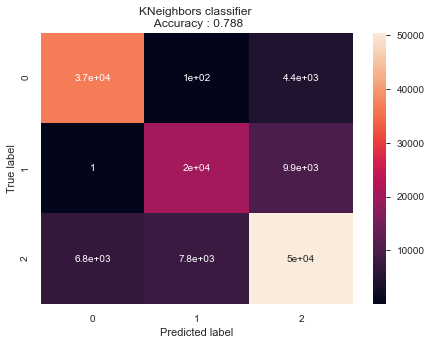

In [107]:
import seaborn as sns
confusion = confusion_matrix(y_test, y_predict)
df1 = pd.DataFrame(confusion)
plt.figure(figsize = (7, 5))
sns.heatmap(df1, annot = True)
plt.title('KNeighbors classifier \n Accuracy : {0:.3f}'.format(accuracy_score(y_test, y_predict)))
plt.ylabel('True label')
plt.xlabel('Predicted label')

In [108]:
%time
y_pred_tr = model.predict(X_train)
y_pred = model.predict(X_test)

Wall time: 0 ns


In [109]:
print('Train Accuracy %s' % accuracy_score(y_train, y_pred_tr))
print('Train F1-score %s' % f1_score(y_train, y_pred_tr, average=None))
print(classification_report(y_train, y_pred_tr))
confusion_matrix(y_train, y_pred_tr)
print()

print('Test Accuracy %s' % accuracy_score(y_test, y_pred))
print('Test F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))
confusion_matrix(y_test, y_pred)

Train Accuracy 0.7902016351966373
Train F1-score [0.86758557 0.69913829 0.78064328]
              precision    recall  f1-score   support

           0       0.85      0.89      0.87    165103
           1       0.72      0.68      0.70    120687
           2       0.78      0.78      0.78    260444

    accuracy                           0.79    546234
   macro avg       0.78      0.78      0.78    546234
weighted avg       0.79      0.79      0.79    546234


Test Accuracy 0.7877840347395632
Test F1-score [0.86658175 0.69622438 0.77758521]
              precision    recall  f1-score   support

           0       0.84      0.89      0.87     41224
           1       0.72      0.67      0.70     30230
           2       0.78      0.78      0.78     65105

    accuracy                           0.79    136559
   macro avg       0.78      0.78      0.78    136559
weighted avg       0.79      0.79      0.79    136559



array([[36737,   104,  4383],
       [    1, 20367,  9862],
       [ 6824,  7806, 50475]], dtype=int64)